In [36]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import warnings
from tqdm import tqdm
from rdp import rdp
import simplekml

from geopy import Point
from geopy.distance import great_circle
from geopy.distance import distance

warnings.filterwarnings('ignore')

## reading ACM track data

In [8]:
ll_center = pd.read_csv('../data/acm_track/Highway Loop Left Lane 11-4-2022 (time stamps).csv')
rl_center = pd.read_csv('../data/acm_track/Highway Loop Right Lane 11-4-2022 (time stamps).csv')

In [3]:
# average sampling frequency, [hz]
freq = 1 / np.average(ll_center['Time from start of file (s)'].diff().dropna())
freq

99.99999999999999

In [13]:
ll_center.columns

Index(['Time from start of file (s)', 'Latitude (deg)', 'Longitude (deg)',
       'Altitude (m)', 'Distance horizontal (m)', 'Velocity forward (m/s)',
       'Velocity lateral (m/s)', 'Velocity down (m/s)',
       'Speed horizontal (m/s)', 'Heading (deg)', 'Pitch (deg)', 'Roll (deg)',
       'Slip angle (deg)', 'Angular rate forward (deg/s)',
       'Angular rate lateral (deg/s)', 'Angular rate down (deg/s)',
       'Angular rate Xv (deg/s)', 'Angular rate Yv (deg/s)',
       'Angular rate Zv (deg/s)', 'Acceleration forward (m/s²)',
       'Acceleration lateral (m/s²)', 'Acceleration down (m/s²)',
       'Acceleration Xv (m/s²)', 'Acceleration Yv (m/s²)',
       'Acceleration Zv (m/s²)'],
      dtype='object')

In [10]:
coln_to_keep  = [
    'Latitude (deg)', 'Longitude (deg)', # GPS
    'Velocity lateral (m/s)', 'Velocity forward (m/s)', # speed
    'Heading (deg)', 'Pitch (deg)', 'Roll (deg)', # IMU measurements
    'Angular rate Xv (deg/s)', 'Angular rate Yv (deg/s)', 'Angular rate Zv (deg/s)',
    'Acceleration Xv (m/s²)', 'Acceleration Yv (m/s²)', 'Distance horizontal (m)'
]

ll_center = ll_center[coln_to_keep]
rl_center = rl_center[coln_to_keep]

check for empty GPS points

In [5]:
sum(ll_center['Latitude (deg)'].isna()), sum(ll_center['Longitude (deg)'].isna())

(0, 0)

In [6]:
sum(rl_center['Latitude (deg)'].isna()), sum(rl_center['Longitude (deg)'].isna())

(0, 0)

## calculate total length of ACM test track

In [32]:
def track_lane_distance(df):
    
    length_mi = 0

    for index, row in tqdm(df.iterrows()):
        try:
            start = (row['Latitude (deg)'], row['Longitude (deg)'])
            end = (df.iloc[index+1]['Latitude (deg)'], df.iloc[index+1]['Longitude (deg)'])
            length_mi += great_circle(start, end).meters
        except:
            end = (df.iloc[0]['Latitude (deg)'], df.iloc[0]['Longitude (deg)'])
            length_mi += great_circle(start, end).meters
    
    return length_mi

In [33]:
# runtime = 20s

left_lane_length = track_lane_distance(ll_center)
right_lane_length = track_lane_distance(rl_center)

0it [00:00, ?it/s]

70817it [00:13, 5371.55it/s]
82711it [00:15, 5353.54it/s]


In [34]:
# unit: meters
left_lane_length, right_lane_length

(3709.2391985377867, 3825.9242935138027)

In [35]:
# m/data points

left_lane_length / ll_center.shape[0]

0.052377807567925594

## Ramer-Douglas-Peucker algorithm
The Ramer-Douglas-Peucker algorithm is an algorithm for reducing the number of points in a curve that is approximated by a series of points.
https://pypi.org/project/rdp/

In [11]:
left_lane_rdp_mask = rdp(ll_center[['Latitude', 'Longitude']].to_numpy(), epsilon=5, return_mask=True)
right_lane_rdp_mask = rdp(rl_center[['Latitude', 'Longitude']].to_numpy(), epsilon=5, return_mask=True)

In [29]:
right_lane.tail()

,Time from start of file (s),Time from initialisation (s),Time from start of region (s),Time (GPS s),Seconds from midnight Sunday (),Latitude (deg),Latitude,Longitude (deg),Longitude,Altitude (m),...,Angular rate down (deg/s),Angular rate Xv (deg/s),Angular rate Yv (deg/s),Angular rate Zv (deg/s),Acceleration forward (m/s²),Acceleration lateral (m/s²),Acceleration down (m/s²),Acceleration Xv (m/s²),Acceleration Yv (m/s²),Acceleration Zv (m/s²)
42179,422.03,421.73,421.82,1339876214,244214.03,42.238600,422386004.9,-83.557570,-835575702.7,221.011200,...,-0.280491,0.240069,-0.246945,-0.274447,-2.373736,-0.096095,-9.335056,-2.4142,-0.3681,-9.3179
42180,422.04,421.74,421.83,1339876214,244214.04,42.238601,422386005.3,-83.557570,-835575697.6,221.011215,...,0.104611,-0.116310,-0.755158,0.127197,-2.273400,-0.089104,-9.946971,-2.3178,-0.3787,-9.9299
42181,422.05,421.75,421.84,1339876214,244214.05,42.238601,422386005.7,-83.557569,-835575692.6,221.011231,...,-0.262329,-0.429718,-0.151261,-0.256112,-2.276382,0.114236,-9.940100,-2.3210,-0.1745,-9.9289
42182,422.06,421.76,421.85,1339876214,244214.06,42.238601,422386006.1,-83.557569,-835575687.5,221.011139,...,0.215958,-0.469825,-0.359245,0.228610,-2.478139,-0.102263,-9.417401,-2.5210,-0.3749,-9.3991
42183,422.07,421.77,421.86,1339876214,244214.07,42.238601,422386006.6,-83.557568,-835575682.5,221.011063,...,0.190161,-0.407946,-0.626816,0.210276,-2.484140,0.100812,-9.242125,-2.5272,-0.1661,-9.2295


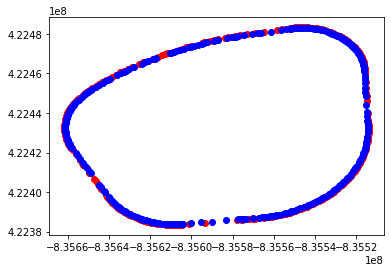

In [18]:
right_lane_rdp = ll_center[right_lane_rdp_mask]
left_lane_rdp = rl_center[left_lane_rdp_mask]
# plt.figure(figsize=(10, 10))
plt.scatter(right_lane_rdp.Longitude, right_lane_rdp.Latitude, c='red')
plt.scatter(left_lane_rdp.Longitude, left_lane_rdp.Latitude, c='blue')
# plt.colorbar(sc)

In [24]:
kml = simplekml.Kml()
right_lane_rdp.apply(lambda row: kml.newpoint(coords=[(row["Longitude (deg)"], row["Latitude (deg)"])]), axis=1)
kml.save(path = "/Users/jarvis/Library/Mobile Documents/com~apple~CloudDocs/Desktop/Fall 2022/PATH GSR/data/trajectory/right_lane_rdp.kml")

## speed profile

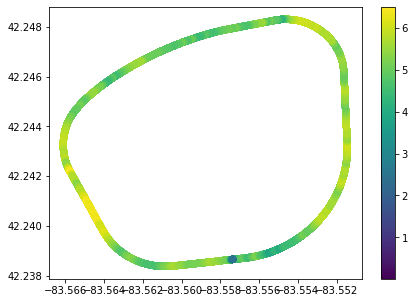

In [40]:
plt.figure(figsize=(7, 5))
sc = plt.scatter(ll_center['Longitude (deg)'], ll_center['Latitude (deg)'], c=ll_center['Velocity forward (m/s)'])
# sc = plt.scatter(left_lane_11_4['Longitude (deg)'], left_lane_11_4['Latitude (deg)'], c=left_lane_11_4['Velocity forward (m/s)'], s=20)

plt.colorbar(sc)

In [41]:
ll_center[ll_center.isna().any(axis=1)]

,Latitude (deg),Longitude (deg),Velocity lateral (m/s),Velocity forward (m/s),Heading (deg),Pitch (deg),Roll (deg),Angular rate Xv (deg/s),Angular rate Yv (deg/s),Angular rate Zv (deg/s),Acceleration Xv (m/s²),Acceleration Yv (m/s²),Distance horizontal (m)


In [42]:
rl_center[rl_center.isna().any(axis=1)]

,Latitude (deg),Longitude (deg),Velocity lateral (m/s),Velocity forward (m/s),Heading (deg),Pitch (deg),Roll (deg),Angular rate Xv (deg/s),Angular rate Yv (deg/s),Angular rate Zv (deg/s),Acceleration Xv (m/s²),Acceleration Yv (m/s²),Distance horizontal (m)


## augment lane marking

- assuming the center lane trajectory data can accurately represent the lane center coordinates of each perspective lane (left, right).
- assuming the standard lane width of 12 feet, https://safety.fhwa.dot.gov/geometric/pubs/mitigationstrategies/chapter3/3_lanewidth.cfm
- using geopy package, laterally augment the left and right lane marking from the center-lane points
- using geodesic distance over great circle distance for more accurate results

In [11]:
ll_center.head()

,Latitude (deg),Longitude (deg),Velocity lateral (m/s),Velocity forward (m/s),Heading (deg),Pitch (deg),Roll (deg),Angular rate Xv (deg/s),Angular rate Yv (deg/s),Angular rate Zv (deg/s),Acceleration Xv (m/s²),Acceleration Yv (m/s²),Distance horizontal (m)
0,42.238643,-83.557448,0.0,0.01,82.408,0.538,0.155,-0.17,-0.87,-0.49,0.110,-0.005,0.0
1,42.238643,-83.557448,0.0,0.01,82.404,0.540,0.154,-0.04,0.18,-0.39,0.054,-0.080,0.0
2,42.238643,-83.557448,0.0,0.01,82.404,0.546,0.154,-0.03,0.56,0.01,0.054,-0.041,0.0
3,42.238643,-83.557448,0.0,0.01,82.404,0.553,0.154,0.02,0.71,0.08,0.132,0.017,0.0
4,42.238643,-83.557448,0.0,0.01,82.410,0.547,0.153,-0.14,-0.55,0.57,0.118,-0.009,0.0


In [62]:
# runtime = ~30s

ll_center_lat, ll_center_lon, ll_heading = ll_center['Latitude (deg)'], ll_center['Longitude (deg)'], ll_center['Heading (deg)']
rl_center_lat, rl_center_lon, rl_heading= rl_center['Latitude (deg)'], rl_center['Longitude (deg)'], rl_center['Heading (deg)']
N = ll_center.shape[0]

# left lane marks
ll_lat_lm, ll_lon_lm, ll_lat_rm, ll_lon_rm = [], [], [], []
# reft lane marks
rl_lat_lm, rl_lon_lm, rl_lat_rm, rl_lon_rm = [], [], [], []

for n in np.arange(N):
    
    # left lane
    lm_point = distance(feet=6).destination(
        (ll_center_lat[n], ll_center_lon[n]), bearing=ll_heading[n] - 90
    )
    
    rm_bearing = ll_heading[n] + 90
    if rm_bearing >= 360:
        rm_bearing = rm_bearing - 360
    rm_point = distance(feet=6).destination(
        Point(ll_center_lat[n], ll_center_lon[n]), bearing=rm_bearing
    )

    lat_lm, lon_lm = lm_point.latitude, lm_point.longitude
    lat_rm, lon_rm = rm_point.latitude, rm_point.longitude

    ll_lat_lm.append(lat_lm)
    ll_lon_lm.append(lon_lm)
    ll_lat_rm.append(lat_rm)
    ll_lon_rm.append(lon_rm)

    # right lane
    lm_point = distance(feet=6).destination(
        (rl_center_lat[n], rl_center_lon[n]), bearing=rl_heading[n] - 90
    )
    
    rm_bearing = rl_heading[n] + 90
    if rm_bearing >= 360:
        rm_bearing = rm_bearing - 360
    rm_point = distance(feet=6).destination(
        Point(rl_center_lat[n], rl_center_lon[n]), bearing=rm_bearing
    )

    lat_lm, lon_lm = lm_point.latitude, lm_point.longitude
    lat_rm, lon_rm = rm_point.latitude, rm_point.longitude

    rl_lat_lm.append(lat_lm)
    rl_lon_lm.append(lon_lm)
    rl_lat_rm.append(lat_rm)
    rl_lon_rm.append(lon_rm)

In [64]:
# graph it
fig = go.Figure()

# left lane left mark
fig.add_trace(go.Scatter(x=ll_lat_lm, y=ll_lon_lm,
                    mode='lines', 
                    name='left lane - left marks'))
# left lane center
fig.add_trace(go.Scatter(x=ll_center_lat, y=ll_center_lon,
                    mode='lines', line = dict(dash = 'dash'),
                    name='left lane - lane center'))
# left lane right mark
fig.add_trace(go.Scatter(x=ll_lat_rm, y=ll_lon_rm,
                    mode='lines',
                    name='left lane - right marks'))

# right lane left mark
fig.add_trace(go.Scatter(x=rl_lat_lm, y=rl_lon_lm,
                    mode='lines', 
                    name='right lane - left marks'))
# right lane center
fig.add_trace(go.Scatter(x=rl_center_lat, y=rl_center_lon,
                    mode='lines', line = dict(dash = 'dash'),
                    name='right lane - lane center'))
# right lane right mark
fig.add_trace(go.Scatter(x=rl_lat_rm, y=rl_lon_rm,
                    mode='lines',
                    name='right lane - right marks'))

fig.update_layout(
    showlegend=False,
    plot_bgcolor="white",
    margin=dict(t=10,l=10,b=10,r=10),
    width=700,
    height=500,
)

fig.update_layout(showlegend=True)
fig.show()